In [2]:
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import matplotlib as mp
import sklearn
import networkx as nx
from IPython.display import Image, HTML

import laUtilities as ut

%matplotlib inline

# Gradient Descent

In linear regression, our goal was to find a parameter vector $\beta$ so that sum of squared error $\Vert \mathbf{y} - \hat{\mathbf{y}}\Vert ^2$ was minimized.

In many cases of interest, we would like to find a maximum likelihood solution but do not have a closed form that we can solve.

It's time now to talk about how, in general, one can find "good values" for the parameters in problems like these.

To do this, first we define an error function, generally called a __loss__ function, to describe how well our method is doing.

Crucially, we choose loss functions that are __differentiable__ with respect to the parameters.

Using differentiable loss functions we can think of the parameter tuning problem using surfaces like these:

<center>
    
<img src="images/convex-cost-function.png" width="75%">
    
</center> 

Imagine that the $x$ and $y$ axes in these pictures represent parameter settings.   That is, we have two parameters to set, corresponding to the values of $x$ and $y$.

For each $(x, y)$ setting, the $z$-axis shows the value of the loss function. 

What we want to do is find the minimum of a surface, corresponding to the parameter settings that minimize loss.

Notice the difference between the two kinds of surfaces.    

The surface on the left corresponds to a __strictly convex__ loss function.   If we find a local minimum of this function, it is a global minimum.

The surface on the right corresponds to a __non-convex__ loss function.   There are local minima that are not globally minimal.

Both kinds of loss functions arise in machine learning.

For example, convex loss functions arise in
* Linear regression
* Logistic regression

While non-convex loss functions arise in 
* $k$-means
* Gaussian Mixture Modeling
* and many other settings

We will try to minimize our loss functions using various forms of gradient descent.

## Gradient Descent Intuitively

Imagine you are lost in the mountains, and it is foggy out.  You want to find a valley.  But since it is foggy, you can only see the local area around you.

<!-- Image credit http://nederlandliving.com/?p=1931 -->

<center>
    
<img src="images/fog-in-the-mountains.png" width="30%">
    
</center> 

The natural thing to do is: 
1. Look around you 360 degrees.  
2. Observe in which direction the ground is sloping downward most steeply.  
3. Take a few steps in that direction.  
4. Repeat the process <BR> ... until the ground seems to be level.

## Formalizing Gradient Descent

The key to this intuitive idea is formalizing the idea of "direction of steepest descent."

This is where the differentiability of the loss function comes into play: as long as the loss function is differentiable, we can define the direction of steepest descent.

And as we showed in the last lecture, the direction of steepest descent is the __gradient.__

Let's say we have a loss function $\mathcal{L}(\mathbf{w})$ that we'd like to minimize.

The components of $\mathbf{w}\in\mathbb{R}^n$ are the parameters we want to optimize.

For example, if our problem is linear regression, the loss function could be:
    
$$ \mathcal{L}(\mathbf{w}) = \Vert\mathbf{y} - \hat{\mathbf{y}}\Vert^2 $$

where $\hat{\mathbf{y}}$ is our estimate, ie, $\hat{\mathbf{y}} = X\mathbf{w}$ so that 

$$ \mathcal{L}(\mathbf{w}) = \Vert\mathbf{y} - X\mathbf{w}\Vert^2 $$

To find the gradient, we take the partial derivative of our loss function with respect to each parameter:

$$ \frac{\partial \mathcal{L}}{\partial w_i} $$

and collect all the partial derivatives into a vector of the same shape as $\mathbf{w}$:

$$ \nabla_\mathbf{w}\mathcal{L} = \begin{bmatrix}
    \frac{\partial \mathcal{L}}{\partial w_1}\\
    \frac{\partial \mathcal{L}}{\partial w_2}\\
    \vdots \\
    \frac{\partial \mathcal{L}}{\partial w_n}
   \end{bmatrix}
   $$

As a reminder, when you see the notation  $\nabla_\mathbf{w}\mathcal{L},$ think of it as $ \frac{d\mathcal{L}}{d\mathbf{w}} $, keeping in mind that $\mathbf{w}$ is a vector.

As discussed in the last lecture, if we are going to take a small step of unit length, then the gradient is the direction that maximizes the change in the loss function.

<!-- Image credit https://www.analyticsvidhya.com/blog/2020/10/how-does-the-gradient-descent-algorithm-work-in-machine-learning/ -->

<center>
    
<img src="images/gradient-of-convex.png" width="60%">
    
</center> 

As you can see from the above figure, in general the gradient varies depending on where you are in the parameter space.

So we write:

$$ \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}) = \begin{bmatrix}
    \frac{\partial \mathcal{L}}{\partial w_1}(\mathbf{w})\\
    \frac{\partial \mathcal{L}}{\partial w_2}(\mathbf{w})\\
    \vdots \\
    \frac{\partial \mathcal{L}}{\partial w_n}(\mathbf{w})
   \end{bmatrix}
   $$
   

Each time we seek to improve our parameter estimates $\mathbf{w}$, we will take a step in the negative direction of the gradient.

... "negative direction" because the gradient specifies the direction of maximum increase -- and we want to decrease the loss function.

How big a step should we take? 

For step size, will use a scalar value $\eta$ called the __learning rate.__

The learning rate is a __hyperparameter__ that needs to be tuned for a given problem, or even can be modified adaptively as the algorithm progresses.

Now we can write the __gradient descent__ algorithm formally:

1. Start with an initial parameter estimate $\mathbf{w}^0$.
2. Update: $\mathbf{w}^{n+1} = \mathbf{w}^n - \eta \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}^n)$
3. If not converged, go to step 2.

How do we know if we are "converged"?  

Typically we stop the iteration if the loss has not improved by a fixed amount for a pre-decided number, say 10 or 20, iterations.

## Example: Linear Regression

Let's say we have this dataset.

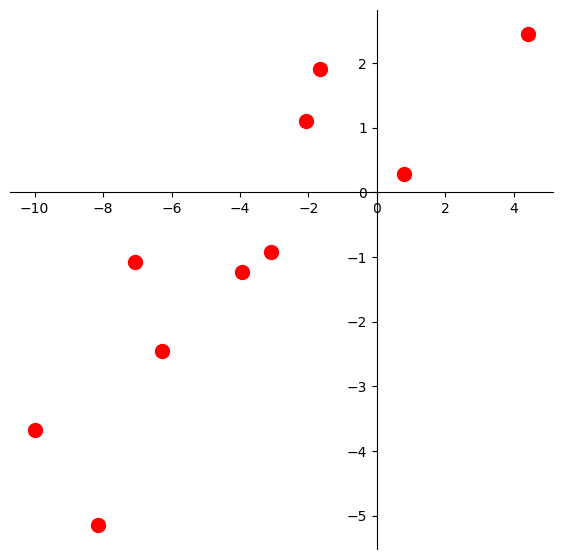

In [4]:
def centerAxes(ax):
    ax.spines['left'].set_position('zero')
    ax.spines['right'].set_color('none')
    ax.spines['bottom'].set_position('zero')
    ax.spines['top'].set_color('none')
    ax.xaxis.set_ticks_position('bottom')
    ax.yaxis.set_ticks_position('left')
    bounds = np.array([ax.axes.get_xlim(), ax.axes.get_ylim()])
    ax.plot(bounds[0][0],bounds[1][0],'')
    ax.plot(bounds[0][1],bounds[1][1],'')

n = 10
beta = np.array([1., 0.5])
ax = plt.figure(figsize = (7, 7)).add_subplot()
centerAxes(ax)
np.random.seed(1)
xlin = -10.0 + 20.0 * np.random.random(n)
y = beta[0] + (beta[1] * xlin) + np.random.randn(n)
ax.plot(xlin, y, 'ro', markersize = 10);

Let's fit a least-squares line to this data. 

The loss function for this problem is the least-squares error:

$$\mathcal{L}(\mathbf{\beta}) = \Vert\mathbf{y} - X\mathbf{\beta}\Vert^2$$

Of course, we know how to solve this problem using the normal equations, but let's do it using gradient descent instead.

Here is the line we'd like to find:

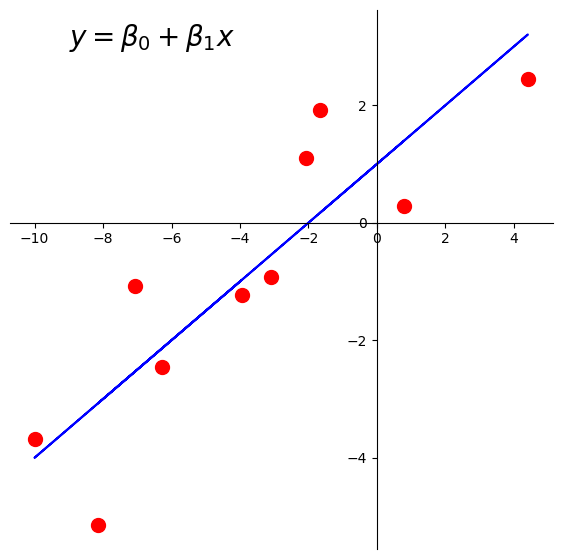

In [5]:
ax = plt.figure(figsize = (7, 7)).add_subplot()
centerAxes(ax)
ax.plot(xlin, y, 'ro', markersize = 10)
ax.plot(xlin, beta[0] + beta[1] * xlin, 'b-')
plt.text(-9, 3, r'$y = \beta_0 + \beta_1x$', size=20);

There are $n = 10$ data points, whose $x$ and $y$ values are stored in `xlin` and `y`.

First, let's create our $X$ (design) matrix, and include a column of ones to model the intercept:

In [7]:
X = np.column_stack([np.ones((n, 1)), xlin])

Now, let's visualize the loss function $\mathcal{L}(\mathbf{\beta}) = \Vert \mathbf{y}-X\mathbf{\beta}\Vert^2.$

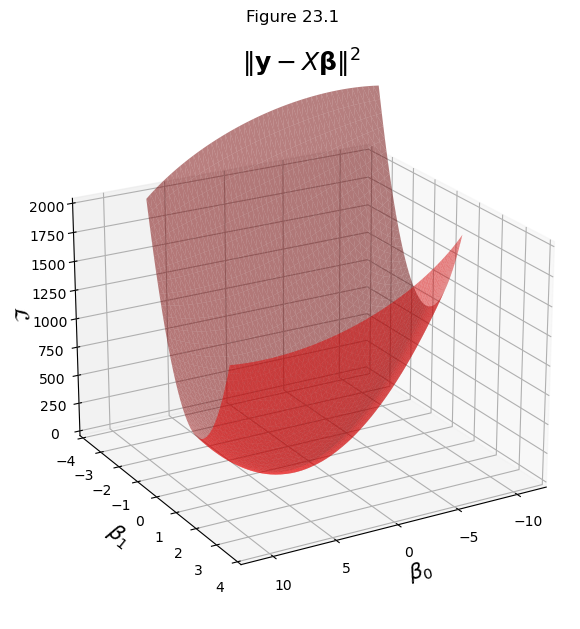

In [5]:
fig = ut.three_d_figure((23, 1), '',
                        -12, 12, -4, 4, -1, 2000, 
                        figsize = (7, 7))
qf = np.array(X.T @ X)
fig.ax.view_init(azim = 60, elev = 22)
fig.plotGeneralQF(X.T @ X, -2 * (y.T @ X), y.T @ y, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'$\Vert \mathbf{y}-X\mathbf{\beta}\Vert^2$', '', 
              number_fig = False, size = 18)
# fig.save();

We actually computed the gradient for this problem in the previous lecture.

So, as a reminder, the gradient for a least squares problem is:
    
$$\nabla_\beta \mathcal{L}(\mathbf{\beta}) = X^T X \beta - X^T\mathbf{y} $$

So here is our code for gradient descent:

In [6]:
def loss(X, y, beta):
    return np.linalg.norm(y - X @ beta) ** 2

def gradient(X, y, beta):
    return X.T @ X @ beta - X.T @ y

def gradient_descent(X, y, beta_hat, eta, nsteps = 1000):
    losses = [loss(X, y, beta_hat)]
    betas = [beta_hat]
    #
    for step in range(nsteps):
        #
        # the gradient step
        new_beta_hat = beta_hat - eta * gradient(X, y, beta_hat)
        beta_hat = new_beta_hat
        #
        # accumulate statistics
        losses.append(loss(X, y, new_beta_hat))
        betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

We'll start at an arbitrary point, say, $(-8, -3.2)$.

That is, $\beta_0 = -8$, and $\beta_1 = -3.2$.

In [7]:
beta_start = np.array([-8, -3.2])
eta = 0.002
betas, losses = gradient_descent(X, y, beta_start, eta)

What happens to our loss function per step of gradient descent?   

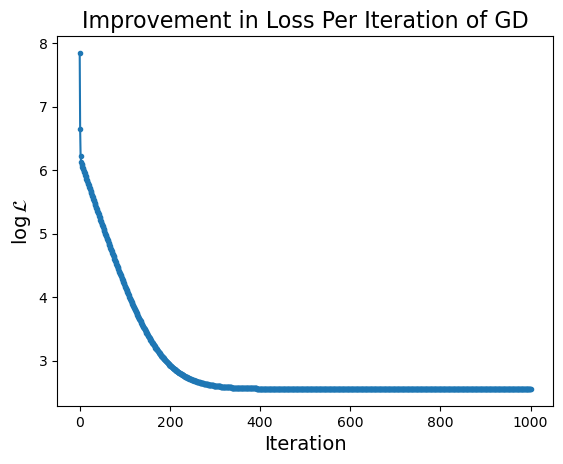

In [8]:
plt.plot(np.log(losses), '.-')
plt.ylabel(r'$\log\mathcal{L}$', size = 14)
plt.xlabel('Iteration', size = 14)
plt.title('Improvement in Loss Per Iteration of GD', size = 16);

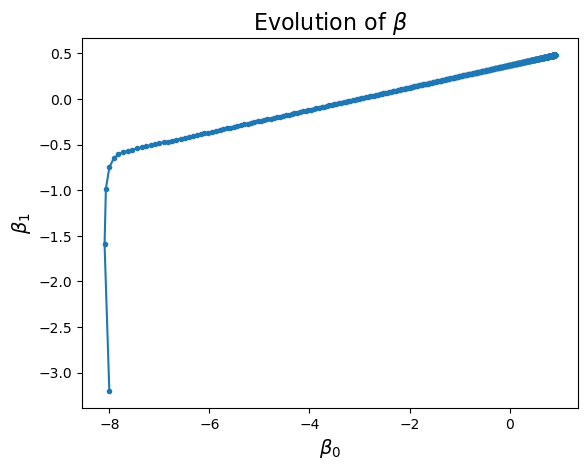

In [9]:
plt.plot(betas[:, 0], betas[:, 1], '.-')
plt.xlabel(r'$\beta_0$', size = 14)
plt.ylabel(r'$\beta_1$', size = 14)
plt.title(r'Evolution of $\beta$', size = 16);

Notice that the improvement in loss decreases over time.  Initially the gradient is steep and loss improves fast, while later on the gradient is shallow and loss doesn't improve much per step.

Now remember that in reality we are like the person who is trying to find their way down the mountain, in the fog.

In general we cannot "see" the entire loss function surface.

Nonetheless, since we know what the loss surface looks like in this case, we can visualize the algorithm "moving" on that surface.

This visualization combines the last two plots into a single view.

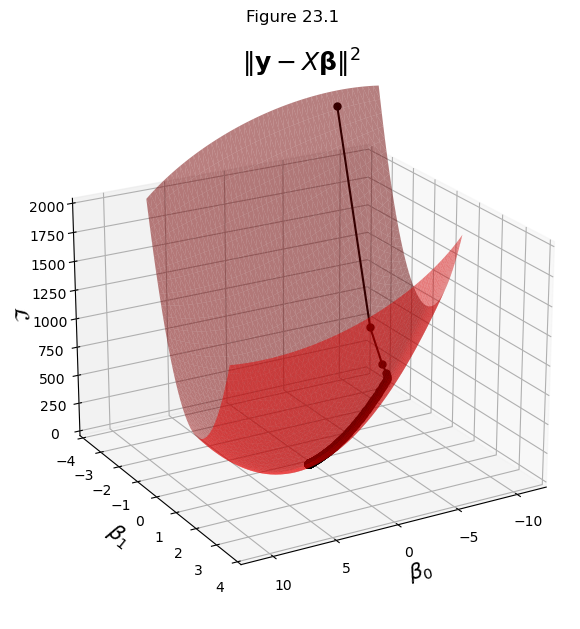

In [10]:
%matplotlib inline
fig = ut.three_d_figure((23, 1), '',
                        -12, 12, -4, 4, -1, 2000, 
                        figsize = (7, 7))
qf = np.array(X.T @ X)
fig.ax.view_init(azim = 60, elev = 22)
fig.plotGeneralQF(X.T @ X, -2 * (y.T @ X), y.T @ y, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'$\Vert \mathbf{y}-X\mathbf{\beta}\Vert^2$', '', 
              number_fig = False, size = 18)
fig.ax.plot(betas[:, 0], betas[:, 1], 'o-', zs = losses,  c = 'k', markersize = 5);
#

Next we can visualize how the algorithm progresses, both in parameter space and in data space:

In [11]:
%matplotlib inline
# set up view
import matplotlib.animation as animation
mp.rcParams['animation.html'] = 'jshtml'

anim_frames = np.array(list(range(10)) + [4 * x for x in range(5, 25)] + [10 * x for x in range(10, 50)])

fig = ut.three_d_figure((23, 1), 'z = 3 x1^2 + 7 x2 ^2',
                        -12, 12, -4, 4, -1, 2000, 
                        figsize = (6, 6))
plt.close()
fig.ax.view_init(azim = 60, elev = 22)
qf = np.array(X.T @ X)
fig.plotGeneralQF(X.T @ X, -2 * (y.T @ X), y.T @ y, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'$\Vert \mathbf{y}-X\mathbf{\beta}\Vert^2$', '', 
              number_fig = False, size = 18)
#
def anim(frame):
    fig.ax.plot(betas[:frame, 0], betas[:frame, 1], 'o-', zs = losses[:frame],  c = 'k', markersize = 5)
    # fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig.fig, anim,
                       frames = anim_frames,
                       fargs = None,
                       interval = 1,
                       repeat = False)

In [12]:
fig, ax = plt.subplots(figsize = (7, 7))
plt.close()
centerAxes(ax)
ax.plot(xlin, y, 'ro', markersize = 10)
fit_line = ax.plot([], [])

#
#to get additional args to animate:
#def animate(angle, *fargs):
#    fargs[0].view_init(azim=angle)
def animate(frame):
    fit_line[0].set_data(xlin, betas[frame, 0] + betas[frame, 1] * xlin)
    fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig, animate,
                       frames = anim_frames,
                       fargs=None,
                       interval=100,
                       repeat=False)

## Challenges in Gradient Descent

Gradient Descent is a very general algorithm, one that can be applied to a huge array of problem types.

However, there are a variety of issues that arise in using gradient descent in practice.

### Learning Rate

Setting the learning rate can be a challenge.

Previously we had set the learning rate $\eta = 0.002$.   

Let set it a little higher and see what happens:  $\eta = 0.0065.$

In [13]:
beta_start = np.array([-8, -2])
eta = 0.0065
betas, losses = gradient_descent(X, y, beta_start, eta, nsteps = 100)

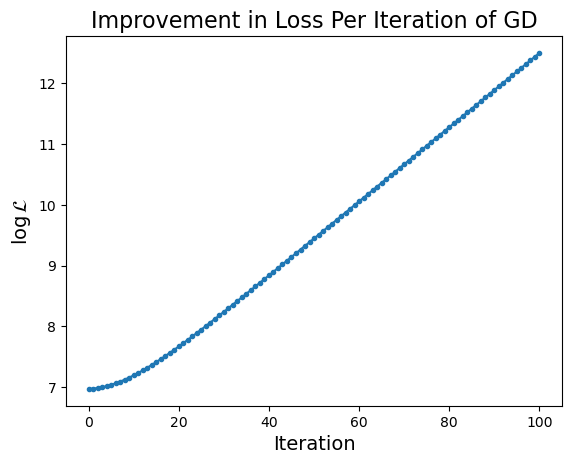

In [14]:
plt.plot(np.log(losses), '.-')
plt.ylabel(r'$\log\mathcal{L}$', size = 14)
plt.xlabel('Iteration', size = 14)
plt.title('Improvement in Loss Per Iteration of GD', size = 16);

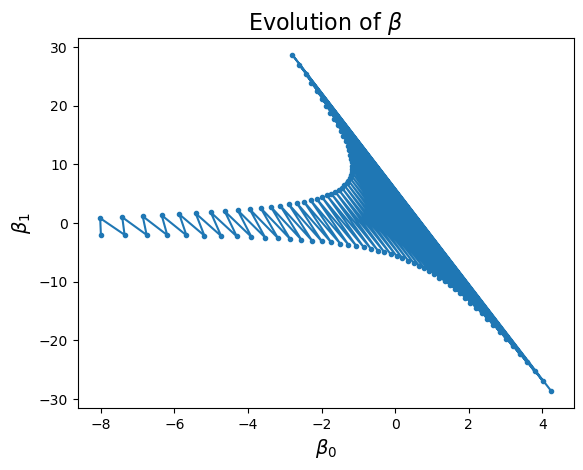

In [15]:
plt.plot(betas[:, 0], betas[:, 1], '.-')
plt.xlabel(r'$\beta_0$', size = 14)
plt.ylabel(r'$\beta_1$', size = 14)
plt.title(r'Evolution of $\beta$', size = 16);

This is a total disaster.  What is going on?  

It is helpful to look at the progress of the algorithm using the loss surface:

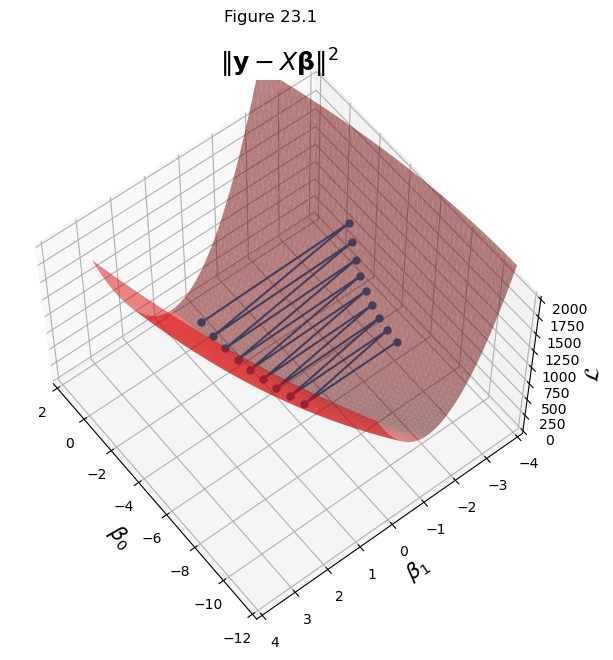

In [16]:
%matplotlib inline
fig = ut.three_d_figure((23, 1), '',
                        -12, 2, -4, 4, -1, 2000, 
                        figsize = (7, 7))
qf = np.array(X.T @ X)
fig.ax.view_init(azim = 142, elev = 58)
fig.plotGeneralQF(X.T @ X, -2 * (y.T @ X), y.T @ y, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'$\Vert \mathbf{y}-X\mathbf{\beta}\Vert^2$', '', 
              number_fig = False, size = 18)
nplot = 18
fig.ax.plot(betas[:nplot, 0], betas[:nplot, 1], 'o-', zs = losses[:nplot], markersize = 5);
#

We can see what is going on more clearly here.  

What is happening is that because the steps are __too large,__ each step overshoots the local minimum.  

The next step then lands on a portion of the surface that steeper ... and in the opposite direction.

And so the process diverges.

```{note} 
For an interesting comparison, try setting $\eta = 0.0055$ and observe the evolution of $\beta$.
```

Hence it is important to decrease the step size when divergence appears.  

Unfortunately, on a complicated loss surface, a given step size may diverge in one location or starting point, but not in another.

### Complex Loss Surfaces

The loss surface for linear regression is the best possible kind:  it is strictly convex, so it has a single global minimum.

For many problems, the loss surface is more complex. 

In particular, the more complex the model, the more complex the loss surface.

The most complex models in use today are deep neural nets, some of which have billions of parameters.

For example, here is a visualization of the loss surface for a deep neural net:

<!-- https://www.cs.umd.edu/~tomg/projects/landscapes/ -->

<center>
    
<img src="images/complex-landscape.png" width="40%">
    
</center> 

Depending on the starting values of the parameters, gradient descent can get trapped in a local minimum on a surface like this.

Furthermore, the varying magnitude of the gradient in different regions of this surface creates significant convergence challenges.

### Efficiency 

There are two ways in which gradient descent can be slow:
* the number of steps taken
* the time taken in each step

We have discussed how setting the learning rate $\eta$ can affect the number of steps taken.

The time taken in each step depends on the cost of computing the gradient.

To understand the issue here, let's look at the gradient computation more closely.

Assume that the model is denoted $\hat{y} = f(\mathbf{x}; \mathbf{w}).$

That is, any prediction is based on inputs $\mathbf{x}$ and uses parameters $\mathbf{w}$.

The most common loss function is the sum of squared error:
    
$$ \mathcal{L}(\mathbf{w}) = \sum_i (\hat{y}_i - y_i)^2 $$

So

$$ \mathcal{L}(\mathbf{w}) = \sum_i (f(\mathbf{x}_i; \mathbf{w}) - y_i)^2 $$

Now note that the gradient operator is a linear operator.  In other words:

$$ \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}) = \nabla_\mathbf{w} \sum_i \left[(f(\mathbf{x}_i; \mathbf{w}) - y_i)^2\right] $$

$$  = \sum_i \nabla_\mathbf{w}\left[(f(\mathbf{x}_i; \mathbf{w}) - y_i)^2\right] $$

So the gradient is a sum of terms, each of which is the gradient with respect to a single data item.

Just using the rules of calculus, we can go even further:
    
$$ \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}) = \sum_i 2 \cdot (f(\mathbf{x}_i; \mathbf{w}) - y_i) \cdot \nabla_\mathbf{w}f(\mathbf{x}_i; \mathbf{w})$$

We can interpret this intuitively:

$$ \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}) = \sum_i 2 \cdot \underbrace{(f(\mathbf{x}_i; \mathbf{w}) - y_i)}_\text{size, sign of error}\;\cdot\underbrace{\nabla_\mathbf{w}f(\mathbf{x}_i; \mathbf{w})}_\text{dir. of prediction increase}$$

Now, with this formulation in mind, we can introduce the __most common__ form of gradient descent: __stochastic gradient descent.__

### Stochastic Gradient Descent

In modern big data problems, evaluating the gradient over all the (billions) of data points can be expensive.

Often it turns out that a good estimate of the gradient can be computed from a subset of the data.

In the extreme case, we could compute the gradient of a single data point.

Let's see what that looks like for linear regression.

$$ \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}) = \sum_i 2 \cdot (\mathbf{x}_i^T\beta - y_i) \cdot \nabla_\mathbf{\beta} \mathbf{x}_i^T\beta$$

Again, the rules of calculus for vectors are similar to scalars.  

Similar to $\frac{d}{dx} ax = a$, we find $\nabla_\mathbf{\beta} \mathbf{x}_i^T\beta = \mathbf{x}_i.$

So:

$$ \nabla_\mathbf{w}\mathcal{L}(\mathbf{w}) = 2 \cdot \sum_i  (\mathbf{x}_i^T\beta - y_i) \cdot \mathbf{x}_i$$

So for linear regression, the loss gradient with respect to a single data point is:
    
$$ (\mathbf{x}_i^T\beta - y_i) \cdot \mathbf{x}_i $$

The idea of __stochastic gradient descent__ is: 

 Instead of computing the gradient based on all the data, compute it based on a single data point.  

Then repeat the above, iterating over every data point.

So the algorithm for stochastic gradient descent for a dataset of $n$ points is:

1. Start with an initial parameter estimate $\mathbf{w}^0$.
2. for i = 1 to $n$:
    1. Update: $\mathbf{w}^{m+1} = \mathbf{w}^m - \eta \cdot (f(\mathbf{x}_i; \mathbf{w}^m) - y_i) \cdot \nabla_\mathbf{w}f(\mathbf{x}_i; \mathbf{w}^m)$
3. If not converged, go to step 2.

In [17]:
def loss(X, y, beta):
    return np.linalg.norm(y - X @ beta) ** 2

def point_gradient(x, y, beta):
    return (x.T @ beta - y) * x

def stochastic_gradient_descent(X, y, beta_hat, eta, nsteps = 1000):
    losses = [loss(X, y, beta_hat)]
    betas = [beta_hat]
    #
    for step in range(nsteps):
        #
        for i in range(X.shape[0]):
            #
            # the gradient step
            new_beta_hat = beta_hat - eta * point_gradient(X[i], y[i], beta_hat)
            beta_hat = new_beta_hat
            #
            # accumulate statistics
            losses.append(loss(X, y, new_beta_hat))
            betas.append(new_beta_hat)
        
    return np.array(betas), np.array(losses)

Let's see how well this works in practice:

In [18]:
beta_start = np.array([-8, -3.2])
eta = 0.002
betas, losses = stochastic_gradient_descent(X, y, beta_start, eta, nsteps = 400)

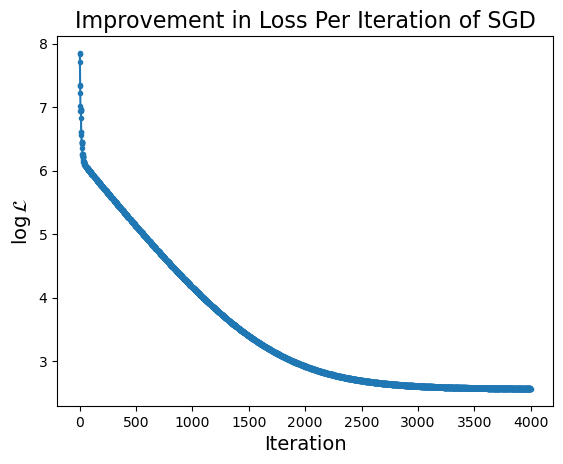

In [19]:
plt.plot(np.log(losses), '.-')
plt.ylabel(r'$\log\mathcal{L}$', size = 14)
plt.xlabel('Iteration', size = 14)
plt.title('Improvement in Loss Per Iteration of SGD', size = 16);

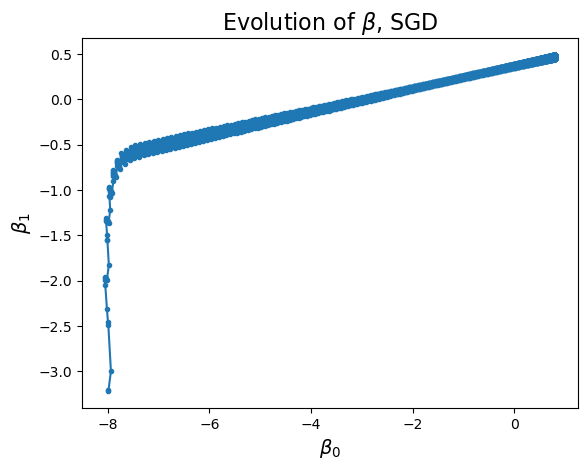

In [20]:
plt.plot(betas[:, 0], betas[:, 1], '.-')
plt.xlabel(r'$\beta_0$', size = 14)
plt.ylabel(r'$\beta_1$', size = 14)
plt.title(r'Evolution of $\beta$, SGD', size = 16);

In these plots, each plot point corresponds to an update based on a single data point.

Clearly, the progress is more erratic;  we are not taking the most efficent path possible.

We can see in the evolution of $\beta$ that we don't go __exactly__ in the correct direction, but close enough that we eventually get to the correct solution.

And each step only requires 1/$n$ times as much computation as the full gradient!

And looking at the progress of stochastic gradient descent using the loss surface:

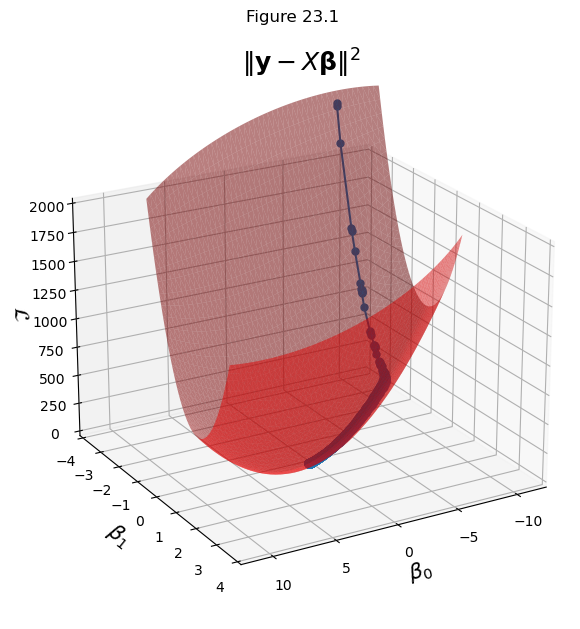

In [21]:
fig = ut.three_d_figure((23, 1), '',
                        -12, 12, -4, 4, -1, 2000, 
                        figsize = (7, 7))
qf = np.array(X.T @ X)
fig.ax.view_init(azim = 60, elev = 22)
fig.plotGeneralQF(X.T @ X, -2 * (y.T @ X), y.T @ y, alpha = 0.5)
fig.ax.set_zlabel('$\mathcal{L}$')
fig.ax.set_xlabel(r'$\beta_0$')
fig.ax.set_ylabel(r'$\beta_1$')
fig.set_title(r'$\Vert \mathbf{y}-X\mathbf{\beta}\Vert^2$', '', 
              number_fig = False, size = 18)
nplot = 4000
fig.ax.plot(betas[:nplot, 0], betas[:nplot, 1], 'o-', zs = losses[:nplot], markersize = 5);

## Different Loss Functions: Logistic Regression

In the linear regression problem, we started with the definition of the loss function:

$$ \mathcal{L}(\mathbf{w}) = \sum_i (\hat{y}_i - y_i)^2 $$

Now we'll take a look at using a different loss function. We'll turn to **logistic regression**.

As we've mentioned in the past, the most natural approach to classification problems is via probability. How should we think about loss in that case?

We will see that much of what we've done already applies just as well.

A typical example of a probabilistic classifier is logistic regression.

The goal of logistic regression is to __maximize the likelihood of the data given the model.__

To simply notation we will define the logistic function 

$$\sigma(t) = \frac{1}{1+e^{-t}} $$

This is the "squashing" function that maps the entire real line $[-\infty, \infty]$ into $[0, 1]$ so the result can be interpreted as a probability.

We then say that $p(y = 1 \mid x) = \sigma(\alpha + \beta x)$

For a single data point, the likelihood function for logistic regression is:

$$L(\alpha, \beta \mid x_i, y_i) = \sigma(\alpha + \beta x_i)^{y_i} (1-\sigma(\alpha + \beta x_i))^{1-y_i}$$

And for multiple data points, we multiply the probabilities of the individual data points:

$$L(\alpha, \beta) = \prod_i \sigma(\alpha + \beta x_i)^{y_i} (1-\sigma(\alpha + \beta x_i))^{1-y_i}$$

We'd like to maximize the likelihood.  We'll take the log of it for convenience.

$$\log L(\alpha, \beta) = \sum_i \log(\sigma(\alpha + \beta x_i)^{y_i} (1-\sigma(\alpha + \beta x_i))^{1-y_i})$$

$$= \sum_i y_i \log(\sigma(\alpha + \beta x_i))+ (1-y_i) \log(1-\sigma(\alpha + \beta x_i))$$

To create a loss function that we can minimize, we negate the log likelihood.   

Negative log likelihood is called __cross entropy__ loss.

$$\mathcal{L}(\alpha, \beta) = - \sum_i y_i \log(\sigma(\alpha + \beta x_i))+ (1-y_i) \log(1-\sigma(\alpha + \beta x_i))$$

Let's denote $\theta = [\alpha, \beta]^T$ and $\mathbf{x}_i = [1, x_i]^T$. In this notation:

$$\mathcal{L}(\mathbf{\theta}) = - \sum_i y_i \log(\sigma(\theta^T\mathbf{x}_i))+ (1-y_i) \log(1-\sigma(\theta^T\mathbf{x}_i))$$

Then it is a relatively straightforward application of calculus (see the online notes) to show that 

$$\nabla_\theta\mathcal{L} = \sum_i (\sigma(\theta^T\mathbf{x}_i) - y_i) \mathbf{x}_i $$

```{note}
To take the gradient, the key is to use calculus to notice that $\frac{d}{dt}\sigma(t) = \sigma(t)(1-\sigma(t))$.  Using this fact, we can 
then find that $\frac{d}{d\mathbf{\theta}} [y_i \log(\sigma(\theta^T\mathbf{x}_i)) + (1-y_i) \log(1-\sigma(\theta^T\mathbf{x}_i))] =  (\sigma(\theta^T\mathbf{x}_i)- y_i) \mathbf{x}_i.$
```

OK, let's see how this applies to a problem.

Here is a typical sort of logistic regression problem (in fact, we took it from Wikipedia!):
    
> A group of 20 students spends between 0 and 6 hours studying for an exam. How does the number of hours spent studying affect the probability of the student passing the exam?

<!-- Source: Wikipedia -->

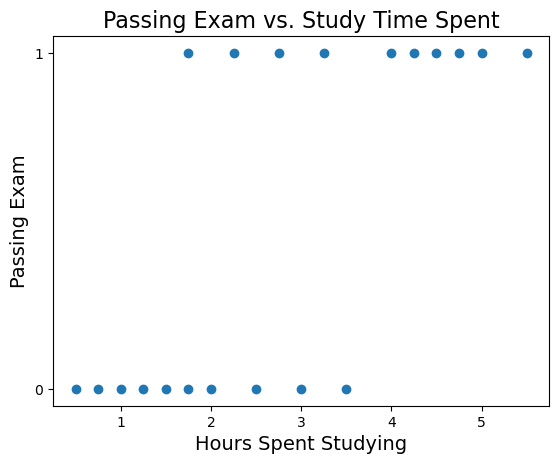

In [22]:
# Data is from the Wikipedia page on Logistic Regression
x = np.array([0.50, 0.75, 1.00, 1.25, 1.50, 1.75, 1.75, 2.00, 2.25, 2.50, 2.75, 3.00, 3.25, 3.50, 4.00, 4.25, 4.50, 4.75, 5.00, 5.50])
y = np.array([0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1])
plt.plot(x, y, 'o')
plt.xlabel('Hours Spent Studying', size = 14)
plt.ylabel('Passing Exam', size = 14)
plt.yticks([0, 1])
plt.title('Passing Exam vs. Study Time Spent', size = 16);

Let's write down our loss and gradient functions.   

Note that we don't need to write a new gradient descent function -- we will just provide a new gradient function.

In [23]:
X = np.column_stack([np.ones((len(x), 1)), x])

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def loss(X, y, theta):
    s = sigmoid(X @ theta)
    return - np.sum(np.array([yi * np.log(si) + (1-yi) * np.log(1-si) for yi, si in zip(y, s)]))

def gradient(X, y, theta):
    return np.sum(np.diag(sigmoid(X @ theta) - y) @ X, axis = 0)


Now we can run gradient descent as before:

In [24]:
theta_start = np.array([1, 1])
eta = 0.01
thetas, losses = gradient_descent(X, y, theta_start, eta)

Unfortunately we no longer have a closed form expression for the loss surface.

Still, we can observe how the loss declines per iteration:

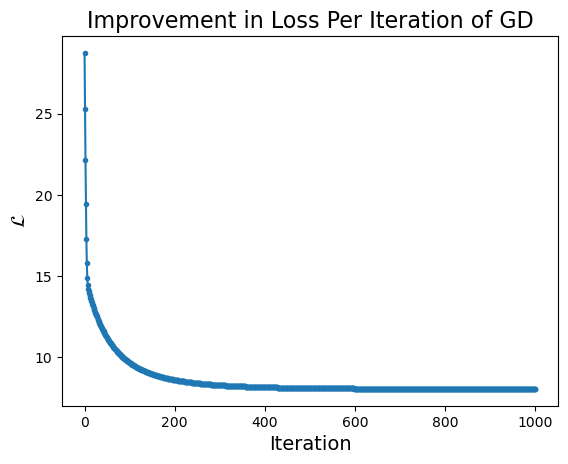

In [25]:
plt.plot(losses, '.-')
plt.ylabel(r'$\mathcal{L}$', size = 14)
plt.xlabel('Iteration', size = 14)
plt.title('Improvement in Loss Per Iteration of GD', size = 16);

And we can see how the parameters evolve, from four different starting points:

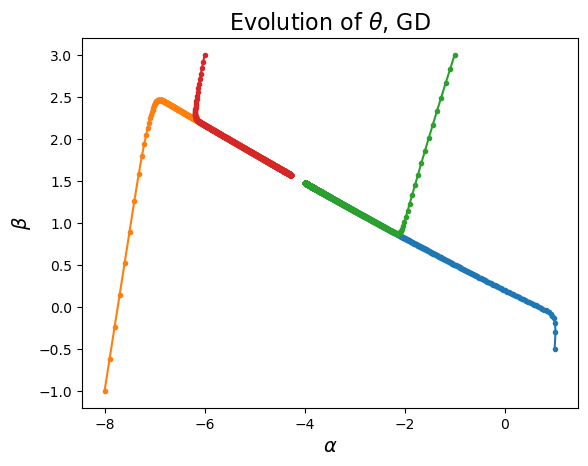

In [26]:
start_points = [[1, -0.5], [-8, -1], [-1, 3], [-6, 3]]
for pt in start_points:
    thetas, losses = gradient_descent(X, y, pt, eta)
    plt.plot(thetas[:, 0], thetas[:, 1], '.-')
plt.xlabel(r'$\alpha$', size = 14)
plt.ylabel(r'$\beta$', size = 14)
plt.title(r'Evolution of $\theta$, GD', size = 16);

And finally we can observe how the logistic function reaches its optimal setting as gradient descent progresses:

In [27]:
theta_start = np.array([1, 1])
eta = 0.01
thetas, losses = gradient_descent(X, y, theta_start, eta)

fig, ax = plt.subplots(figsize = (10, 6))
plt.plot(x, y, 'o')
plt.xlabel('Hours Spent Studying', size = 14)
plt.ylabel('Passing Exam', size = 14)
plt.title('Passing Exam vs. Study Time Spent', size = 16)
plt.yticks([0, 1])
plt.close()
fit_line = ax.plot([], [])

anim_frames = list(range(10)) + [10 * x for x in range(2, 100)]
xvals = np.linspace(0, 7, 200)
#
#to get additional args to animate:
#def animate(angle, *fargs):
#    fargs[0].view_init(azim=angle)
def animate(frame):
    fit_line[0].set_data(xvals, sigmoid(thetas[frame, 0] + thetas[frame, 1] * xvals))
    fig.canvas.draw()
#
# create the animation 
animation.FuncAnimation(fig, animate,
                       frames = anim_frames,
                       fargs=None,
                       interval=100,
                       repeat=False)